In [47]:
from keras.datasets import cifar10
import numpy as np
(x_train, y_train), (x_test, y_test) = cifar10.load_data()

In [48]:
print("x_train",x_train.shape)
print("y_train",y_train.shape)
print("x_test",x_test.shape)
print("y_test",y_test.shape)

x_train (50000, 32, 32, 3)
y_train (50000, 1)
x_test (10000, 32, 32, 3)
y_test (10000, 1)


In [49]:
NUM_CLASSES = 10
cifar10_classes = ["airplane", "automobile", "bird", "cat", "deer", 
                   "dog", "frog", "horse", "ship", "truck"]

# print(y_train[450, 0])                   

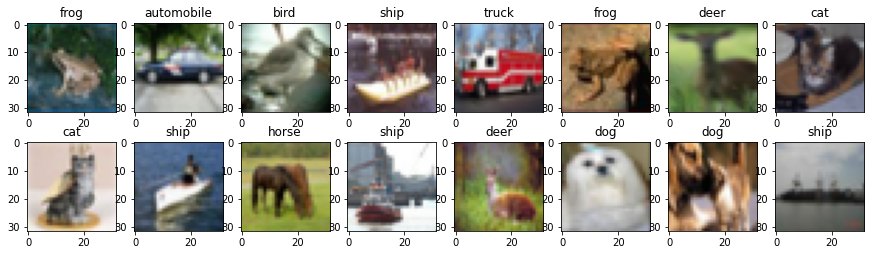

In [50]:

import matplotlib.pyplot as plt
cols = 8
rows = 2

fig = plt.figure(figsize = (2 * cols -1, 2.5 * rows -1))
for i in range(cols):
  for j in range(rows):
     random_index = np.random.randint(0, len(y_train))
     ax = fig.add_subplot(rows, cols, i * rows + j + 1)
     ax.imshow(x_train[random_index, :])
     ax.set_title(cifar10_classes[y_train[random_index, 0]])
plt.show()

In [51]:
from tensorflow.keras.utils import to_categorical
import tensorflow as tf
import keras, keras.layers as L, keras.backend as K
from keras.models import save_model
#%tensorflow_version 1.x

#normalize inputs

x_train2 = (x_train/255).astype(np.float32)
x_test2 = (x_test/255).astype(np.float32)


# y_train2 = to_categorical(y_train)### YOUR CODE HERE
# y_test2 = to_categorical(y_test)

In [52]:
#Validation checks
#check if values are between 0 and 1
assert (x_train2 >= 0).all() and (x_train2 <= 1).all(), "Train values are not between 0 and 1"
assert (x_test2 >= 0).all() and (x_test2 <= 1).all(), "Test values are not between 0 and 1"

#check if values are float32 type
assert (x_train2.dtype) == "float32", "Values are not float32 type"
assert (x_test2.dtype) == "float32", "Values are not float32 type"

print("Variable", "|", "Description", "|", "Shape")
print("x_train", "|", "The images of the training dataset" ,"|", x_train2.shape)
print("y_test",  "|", "The labels of the training dataset" ,"|",y_train.shape)
print("x_test",  "|", "The images of the testing dataset" ,"|",x_test2.shape)
print("y_test",  "|", "The labels of the testing dataset" ,"|",y_test.shape)

Variable | Description | Shape
x_train | The images of the training dataset | (50000, 32, 32, 3)
y_test | The labels of the training dataset | (50000, 1)
x_test | The images of the testing dataset | (10000, 32, 32, 3)
y_test | The labels of the testing dataset | (10000, 1)


In [53]:



def reset_tf_session():
    curr_session = tf.keras.backend.clear_session()
    # close current session
    if curr_session is not None:
        curr_session.close()
    # reset graph
    K.clear_session()
    # create new session
    config = tf.compat.v1.ConfigProto()
    config.gpu_options.allow_growth = True
    #config=config
    s = tf.compat.v1.InteractiveSession()
    K.set_session(s)
    return s


class ModelSaveCallback(keras.callbacks.Callback):

    def __init__(self, file_name):
        super(ModelSaveCallback, self).__init__()
        self.file_name = file_name
        #self.monitor = 'val_accuracy'

    def on_epoch_end(self, epoch, logs=None):
        model_filename = self.file_name.format(epoch)
        save_model(self.model, model_filename)
        print("Model saved in {}".format(model_filename))    

In [54]:


def build_deep_autoencoder(img_shape, latent_size):
    H,W,C = img_shape
    
    # encoder
    encoder = keras.models.Sequential()
    encoder.add(L.InputLayer(img_shape, name="Input Layer"))
    
    ### YOUR CODE HERE: define encoder as per instructions above ###
    encoder.add(L.Conv2DTranspose(filters=32, kernel_size=3, strides=2, activation='elu', padding='same'))
    encoder.add(L.MaxPooling2D(pool_size = 2))
    encoder.add(L.Conv2DTranspose(filters=64, kernel_size=3, strides=2, activation='elu', padding='same'))
    encoder.add(L.MaxPooling2D(pool_size = 2))
    encoder.add(L.Conv2DTranspose(filters=128, kernel_size=3, strides=2, activation='elu', padding='same'))
    encoder.add(L.MaxPooling2D(pool_size = 2))
    encoder.add(L.Conv2DTranspose(filters=256, kernel_size=3, strides=2, activation='elu', padding='same'))
    encoder.add(L.MaxPooling2D(pool_size = 2))
    encoder.add(L.Flatten())
    encoder.add(L.Dense(latent_size))
    
    # decoder
    decoder = keras.models.Sequential()
    decoder.add(L.InputLayer((latent_size), name="Latent Layer"))
    
    ### YOUR CODE HERE: define decoder as per instructions above ###
    decoder.add(L.Dense(2*2*256))
    decoder.add(L.Reshape((2,2,256)))
    decoder.add(L.Conv2DTranspose(filters=128, kernel_size=3, strides=2, activation='elu', padding='same'))
    decoder.add(L.Conv2DTranspose(filters=64, kernel_size=3, strides=2, activation='elu', padding='same'))
    decoder.add(L.Conv2DTranspose(filters=32, kernel_size=3, strides=2, activation='elu', padding='same'))
    decoder.add(L.Conv2DTranspose(filters=3, kernel_size=3, strides=2, activation=None, padding='same'))    
    return encoder, decoder

In [55]:
# def build_deep_autoencoder(img_shape, latent_size):
#     H,W,C = img_shape
    
#     # encoder
#     encoder = keras.models.Sequential()
#     encoder.add(L.InputLayer(img_shape))
    
#     encoder.add(L.Conv2D(filters=32, kernel_size=3, activation='relu', padding='same'))
#     encoder.add(L.MaxPooling2D(pool_size=2))
#     encoder.add(L.Conv2D(filters=64, kernel_size=3, activation='relu', padding='same'))
#     encoder.add(L.MaxPooling2D(pool_size=2))
#     encoder.add(L.Conv2D(filters=128, kernel_size=3, activation='relu', padding='same'))
#     encoder.add(L.MaxPooling2D(pool_size=2))
#     encoder.add(L.Conv2D(filters=256, kernel_size=3, activation='relu', padding='same'))
#     encoder.add(L.MaxPooling2D(pool_size=2))
#     encoder.add(L.Flatten())                 
#     encoder.add(L.Dense(latent_size)) 

#     # decoder
#     decoder = keras.models.Sequential()
#     decoder.add(L.InputLayer((latent_size,)))
    
#     decoder.add(L.Dense(2*2*256))
#     decoder.add(L.Reshape((2,2,256)))
#     decoder.add(L.Conv2DTranspose(filters=128, kernel_size=3, strides=2, activation='sigmoid', padding='same'))
#     decoder.add(L.Conv2DTranspose(filters=64, kernel_size=3, strides=2, activation='sigmoid', padding='same'))
#     decoder.add(L.Conv2DTranspose(filters=32, kernel_size=3, strides=2, activation='sigmoid', padding='same'))
#     decoder.add(L.Conv2DTranspose(filters=3, kernel_size=3, strides=2, activation=None, padding='same'))
    
#     return encoder, decoder

In [56]:
s = reset_tf_session()
encoder, decoder = build_deep_autoencoder(x_train2.shape[1:], latent_size=10)
encoder.summary()
decoder.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_transpose (Conv2DTran (None, 64, 64, 32)        896       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 32, 32, 32)        0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 64, 64, 64)        18496     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_transpose_2 (Conv2DTr (None, 64, 64, 128)       73856     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 32, 32, 128)       0         
_________________________________________________________________
conv2d_transpose_3 (Conv2DTr (None, 64, 64, 256)       2

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1761: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


In [57]:
inp = L.Input(x_train2.shape[1:])
code = encoder(inp)
reconstruction = decoder(code)

autoencoder = keras.models.Model(inputs=inp, outputs=reconstruction)
autoencoder.compile(optimizer="adamax", loss='mse', metrics=['accuracy'])

In [63]:
import datetime

model_filename = 'autoencoder.{0:03d}.hdf5'
last_finished_epoch = None or 0

#### uncomment below to continue training from model checkpoint
#### fill `last_finished_epoch` with your latest finished epoch
from keras.models import load_model
s = reset_tf_session()
# last_finished_epoch = 29
LOADED = True
# autoencoder = load_model("autoencoder.029 (1).hdf5")
# autoencoder = load_model(model_filename.format(last_finished_epoch))
encoder = autoencoder.layers[1]
decoder = autoencoder.layers[2]

log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1761: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


In [64]:
if(~LOADED):

  autoencoder.fit(x=x_train2, y=x_train2, epochs=30,
                validation_data=(x_test2, x_test2),
                callbacks=[ModelSaveCallback(model_filename),tensorboard_callback],
                verbose=1,
                initial_epoch=last_finished_epoch or 0)

Epoch 1/30
1563/1563 [==============================] - 108s 69ms/step - loss: 0.0216 - accuracy: 0.5951 - val_loss: 0.0216 - val_accuracy: 0.5892
Model saved in autoencoder.000.hdf5
Epoch 2/30
1563/1563 [==============================] - 109s 70ms/step - loss: 0.0214 - accuracy: 0.5955 - val_loss: 0.0213 - val_accuracy: 0.6062
Model saved in autoencoder.001.hdf5
Epoch 3/30
1563/1563 [==============================] - 106s 68ms/step - loss: 0.0212 - accuracy: 0.5948 - val_loss: 0.0211 - val_accuracy: 0.6085
Model saved in autoencoder.002.hdf5
Epoch 4/30
1563/1563 [==============================] - 109s 70ms/step - loss: 0.0210 - accuracy: 0.5966 - val_loss: 0.0210 - val_accuracy: 0.5887
Model saved in autoencoder.003.hdf5
Epoch 5/30
1563/1563 [==============================] - 106s 68ms/step - loss: 0.0209 - accuracy: 0.5977 - val_loss: 0.0209 - val_accuracy: 0.6105
Model saved in autoencoder.004.hdf5
Epoch 6/30
1563/1563 [==============================] - 109s 70ms/step - loss: 0.0208

In [65]:
%load_ext tensorboard

In [66]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

In [67]:
!pip install pydotplus

In [68]:
import pydotplus
dot_img_file = '/tmp/model_1.png'
tf.keras.utils.model_to_dot(
    reconstruction,  show_shapes=True, show_dtype=True,
    show_layer_names=True, rankdir='TB', expand_nested=False, dpi=96
)


AttributeError: ignored

In [69]:

def plot_images(original_list):
  plt.figure(figsize=(20,5))
  for i in range(len(original_list)):
    code = encoder.predict(original_list[i][None])[0]
    reco = decoder.predict(code[None])[0]
    ax = plt.subplot(2,10, i+1)
    plt.title("Original" +"  " + cifar10_classes[y_test[i,0]])
    plt.imshow(np.clip(original_list[i], 0,1))

    ax = plt.subplot(2,10, i+1+10)
    plt.title("Recon:" +"  " + cifar10_classes[y_test[i,0]])
    plt.imshow(np.clip(reco, 0,1))    


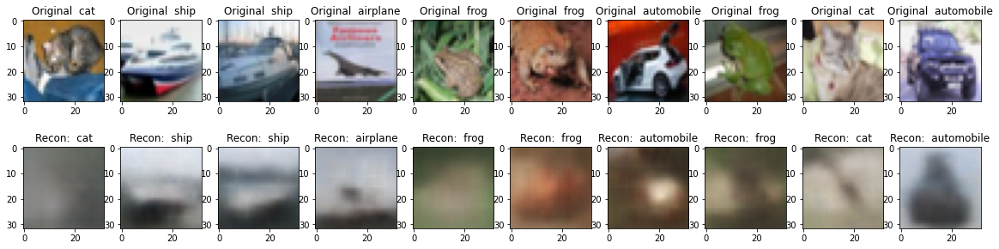

In [70]:
# score = autoencoder.evaluate(x_test2,x_test2,verbose=0)
# print("PCA MSE:", score)

original_list = []
for i in range(10):
    img = x_test2[i]
    original_list.append(img)  
    
plot_images(original_list)

In [71]:
import seaborn as sns
import pandas as pd

In [72]:
print(x_test2[50].shape)

(32, 32, 3)


In [73]:
def random_images_encoder():
      random_images_list = []
      for i in range(50):
          num = np.random.randint(1, high =len(x_test2))
          # print(num)
          random_images_list.append(x_test2[num])
      arr = np.asarray(random_images_list)
      random_encoded = encoder.predict(arr)
      # print(random_encoded.shape) --> (50,10)
      return random_encoded


def splom():
      random_encoded = random_images_encoder()
      splom = pd.DataFrame(random_encoded)
      g = sns.pairplot(splom)
      g.fig.set_size_inches(12,12)
      plt.show()

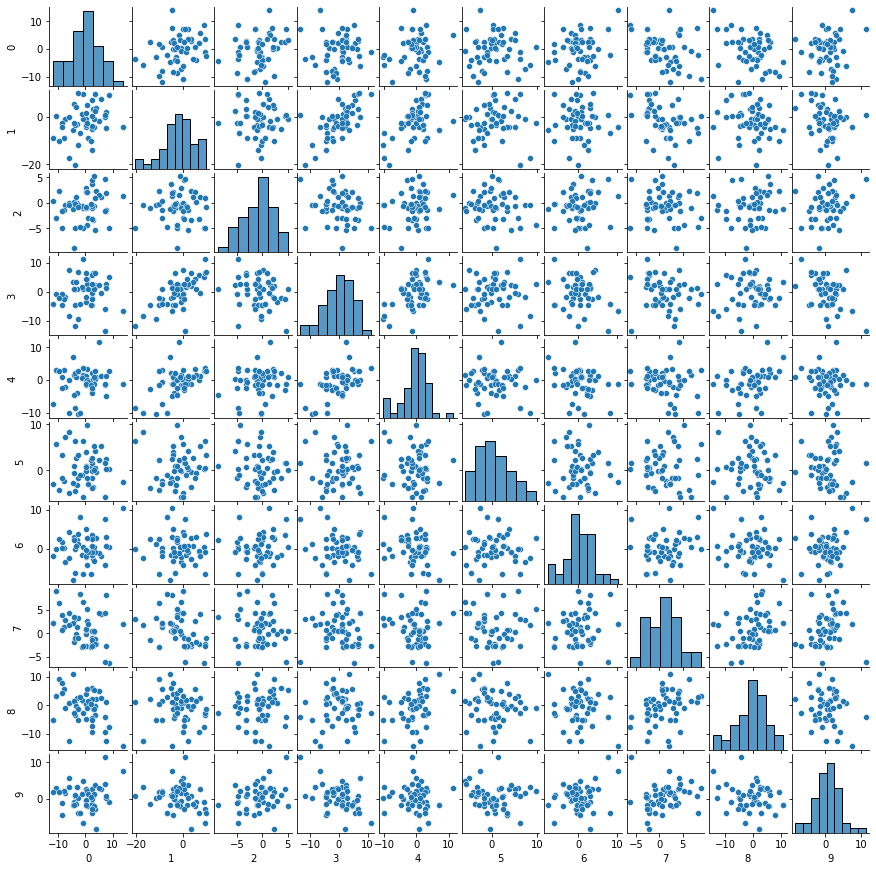

In [74]:
splom()

In [75]:
!pip install umap-learn

     |████████████████████████████████| 81kB 5.3MB/s 
     |████████████████████████████████| 1.2MB 13.3MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.1-cp37-none-any.whl size=76569 sha256=ffc510a5db275d2d454f985e83c9f58912eaa38844f1ed8c48f44ce096beb938
  Stored in directory: /root/.cache/pip/wheels/ad/df/d5/a3691296ff779f25cd1cf415a3af954b987fb53111e3392cf4
  Created wheel for pynndescent: filename=pynndescent-0.5.2-cp37-none-any.whl size=51362 sha256=db9ff725ff464b21fbdf334d2fe1455284c3676490321e0d84eb0fe0723c8dcf
  Stored in directory: /root/.cache/pip/wheels/ba/52/4e/4c28d04d144a28f89e2575fb63628df6e6d49b56c5ddd0c74e
Successfully built umap-learn pynndescent


In [76]:
from umap import UMAP

In [77]:
def umap_plot():
  up = UMAP()
  encod_output = encoder.predict(x_test2)
  embeddings = up.fit_transform(encod_output)
  # print(embeddings.shape) --> (10000,2)
  fig = plt.gcf()
  fig.set_size_inches(20, 11)
  plt.scatter(embeddings[:,0], embeddings[:,1], c=y_test)
  plt.show()

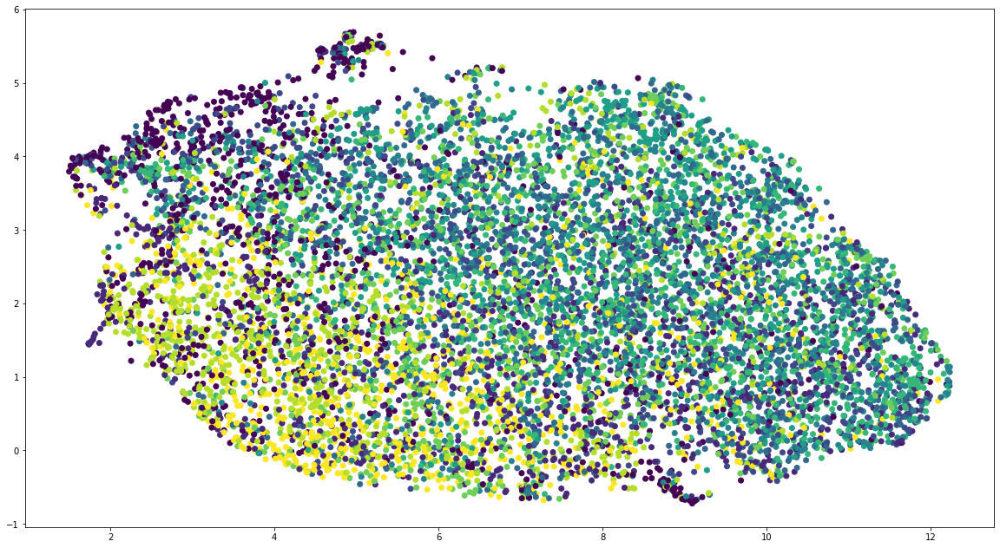

In [78]:
umap_plot()

In [79]:
def plot_images(n, first, second):
        plt.figure(figsize=(20, 4))
        for i in range(n):
          # display original
          ax = plt.subplot(2, n, i + 1)
          plt.imshow(first.reshape(32, 32, 3))
          # display reconstruction
          ax = plt.subplot(2, n, i + 1 + n)
          plt.imshow(second[i].reshape(32, 32, 3))
        plt.show()


In [80]:
from sklearn.metrics import pairwise_distances
def pair_distances(number_of_images = 20):
        metrics = ["manhattan", "euclidean", "cosine"]

        similar_imgs = list()

        combined_data = np.vstack((x_train2,x_test2))
        labels_combined = np.vstack((y_train,y_test))
        # print(combined_data.shape)
        full_encoded = encoder.predict(combined_data)
        # print(full_encoded.shape)
        indexes = list(range(0, full_encoded.shape[0]))

        for j in range(number_of_images):

          num = np.random.randint(1, high =len(combined_data))
          label = cifar10_classes[labels_combined[num,0]]
          org_img = combined_data[num]
          # print(org_img.shape)
          val = encoder.predict(org_img[None])[0]
          val = val.reshape(1,10)
          # print(val.shape)
          # val = np.reshape(val, (1, 10))
          print("############################################", label,"################################")
          for metric in metrics:
            print("##########################################",metric, "################################")
            distance = pairwise_distances(val, full_encoded, metric=metric)
            print(distance.shape)
            result = zip(indexes, distance[0][indexes])
            # print(result[0][0])
            # [(i, distance[0][i]) for i in range(len(indexes))]
            sort_tup = sorted(result, key = lambda x: x[1])
            
            for i in range(10):
              var = combined_data[sort_tup[i][0]]
              similar_imgs.append(var)
            similar = np.asarray(similar_imgs)

            plot_images(10, org_img, similar)
            similar_imgs.clear()

############################################ ship ################################
########################################## manhattan ################################
(1, 60000)


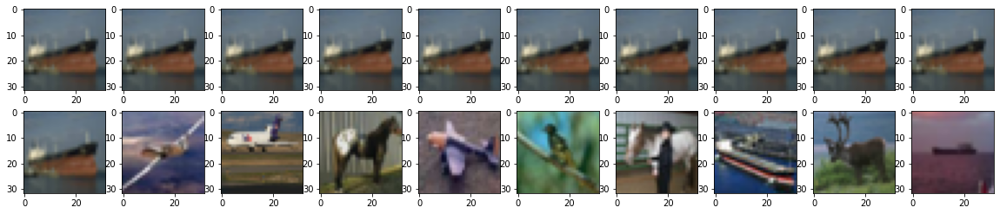

########################################## euclidean ################################
(1, 60000)


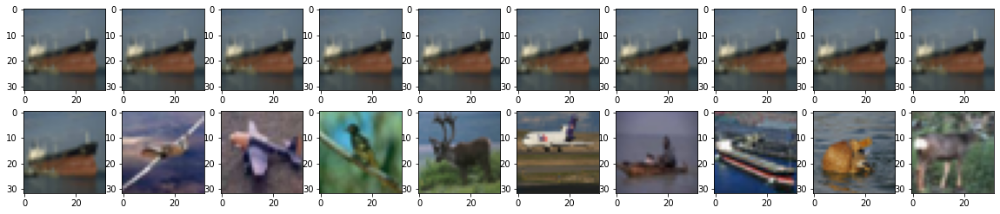

########################################## cosine ################################
(1, 60000)


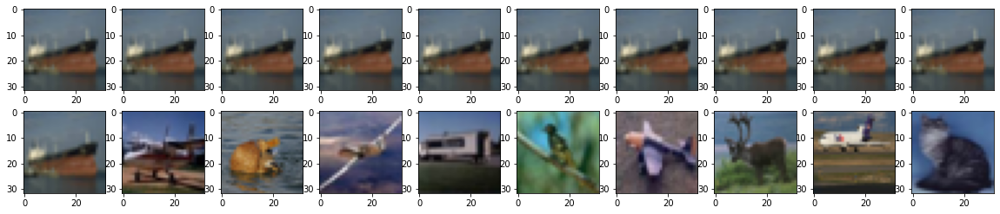

############################################ ship ################################
########################################## manhattan ################################
(1, 60000)


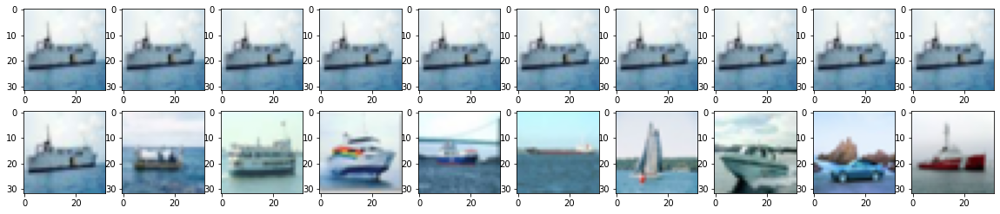

########################################## euclidean ################################
(1, 60000)


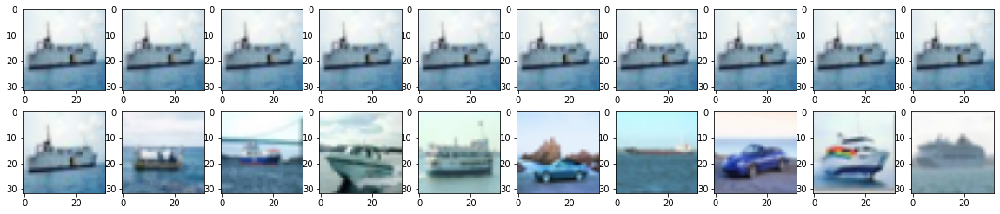

########################################## cosine ################################
(1, 60000)


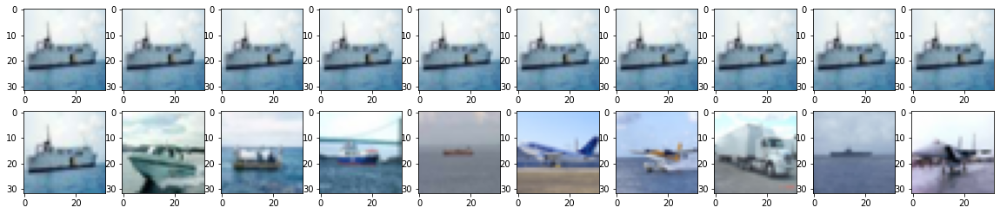

############################################ dog ################################
########################################## manhattan ################################
(1, 60000)


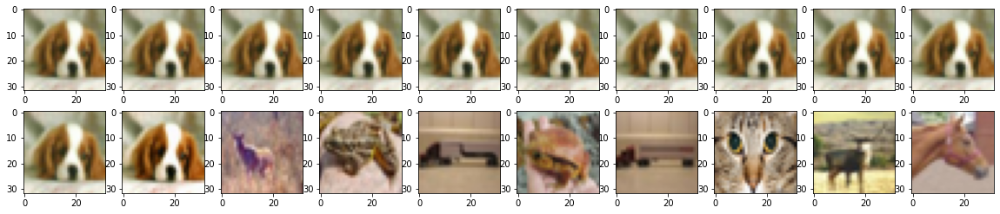

########################################## euclidean ################################
(1, 60000)


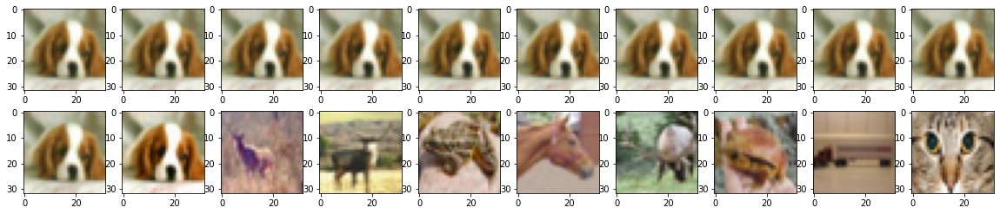

########################################## cosine ################################
(1, 60000)


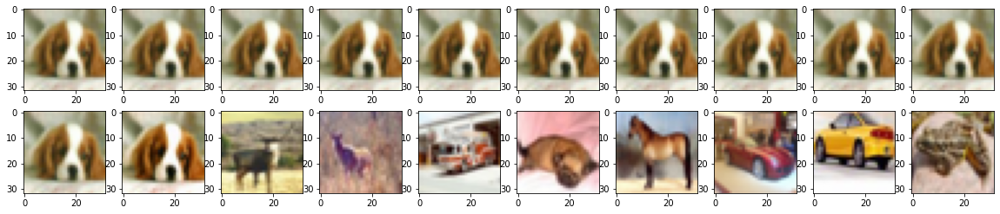

############################################ ship ################################
########################################## manhattan ################################
(1, 60000)


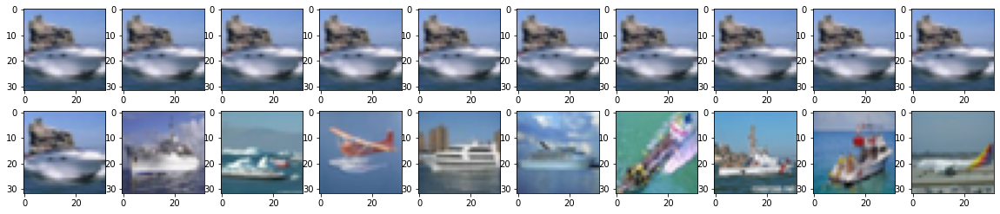

########################################## euclidean ################################
(1, 60000)


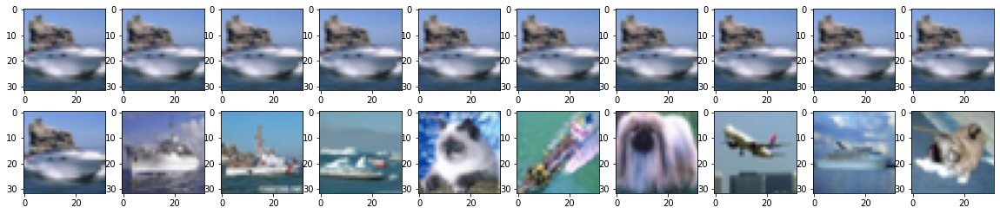

########################################## cosine ################################
(1, 60000)


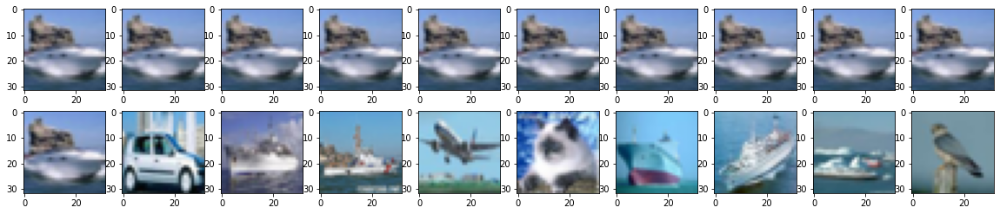

############################################ ship ################################
########################################## manhattan ################################
(1, 60000)


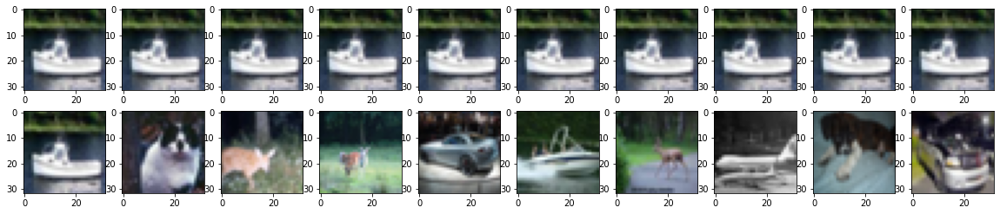

########################################## euclidean ################################
(1, 60000)


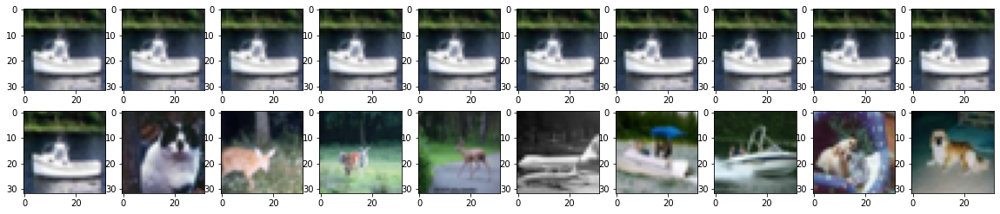

########################################## cosine ################################
(1, 60000)


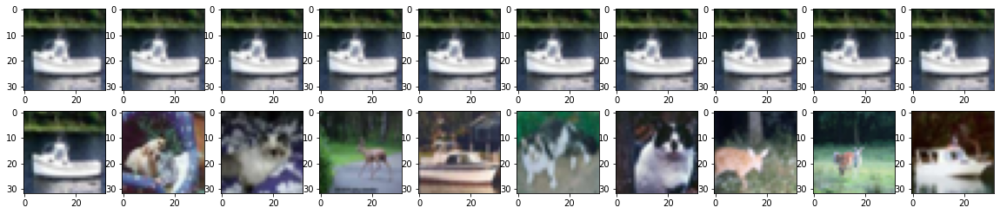

############################################ deer ################################
########################################## manhattan ################################
(1, 60000)


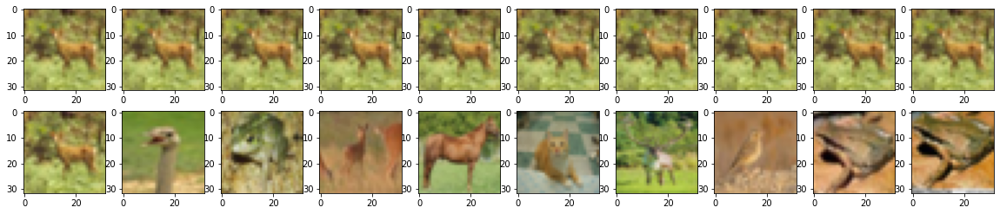

########################################## euclidean ################################
(1, 60000)


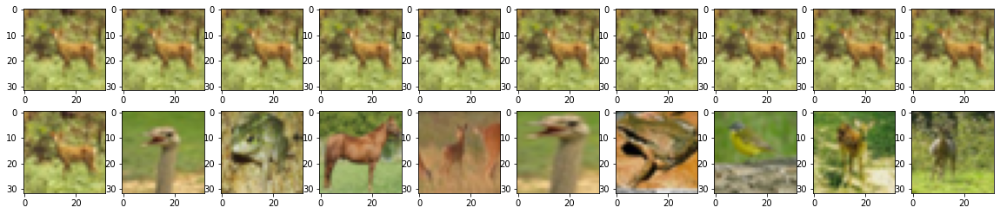

########################################## cosine ################################
(1, 60000)


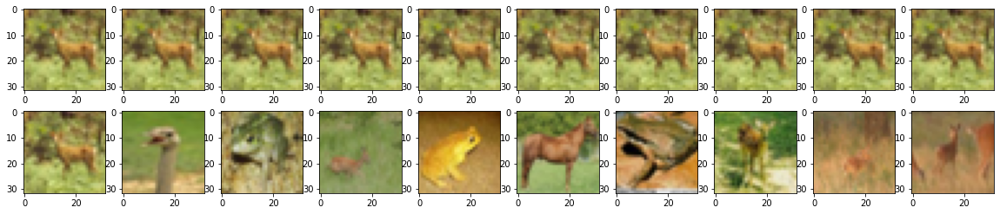

############################################ automobile ################################
########################################## manhattan ################################
(1, 60000)


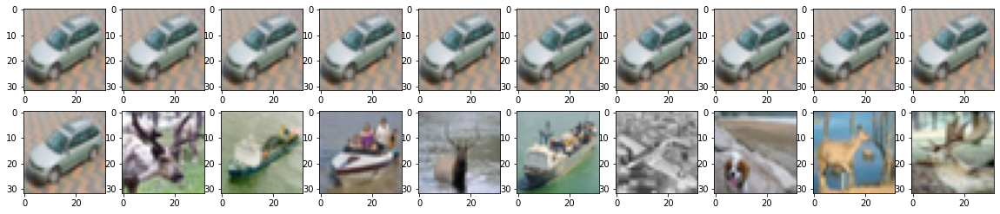

########################################## euclidean ################################
(1, 60000)


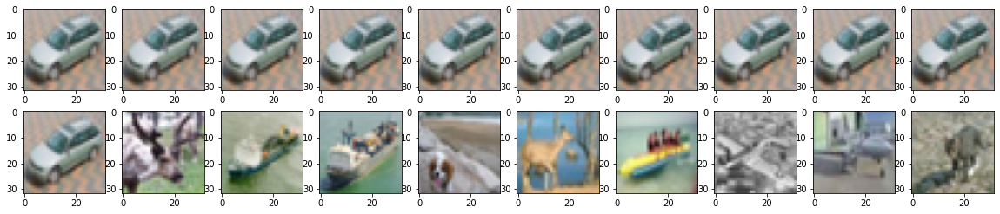

########################################## cosine ################################
(1, 60000)


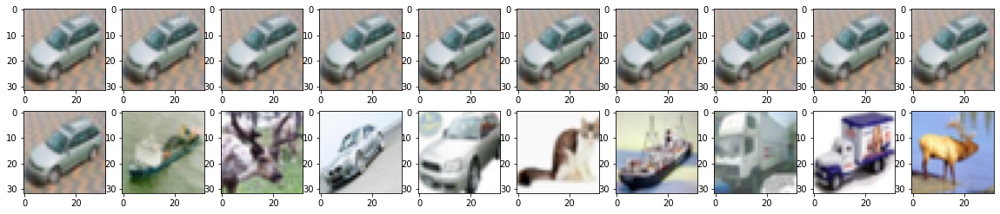

############################################ automobile ################################
########################################## manhattan ################################
(1, 60000)


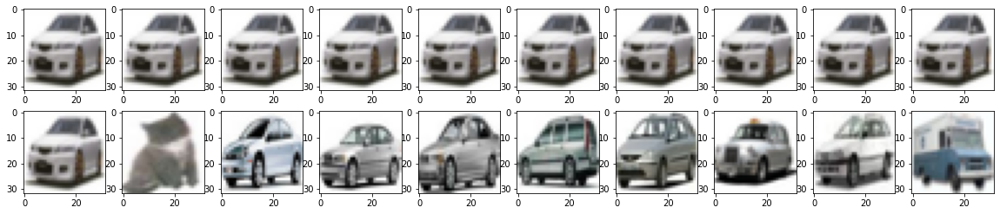

########################################## euclidean ################################
(1, 60000)


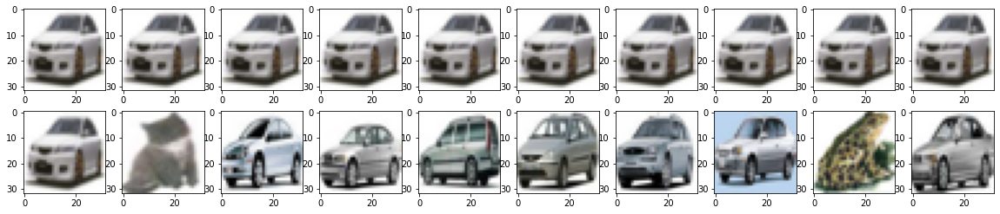

########################################## cosine ################################
(1, 60000)


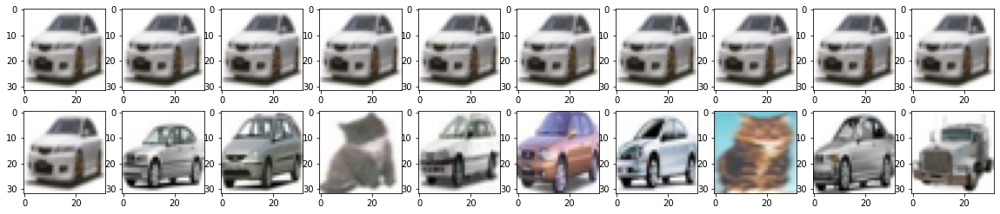

############################################ truck ################################
########################################## manhattan ################################
(1, 60000)


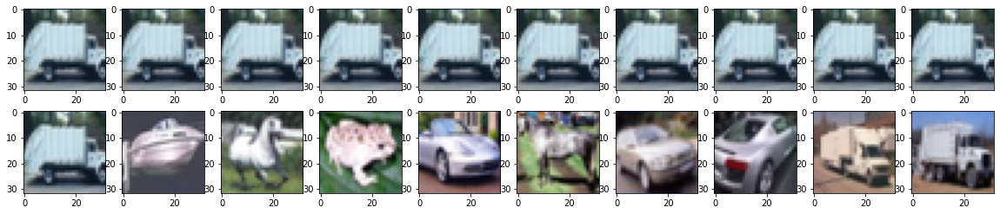

########################################## euclidean ################################
(1, 60000)


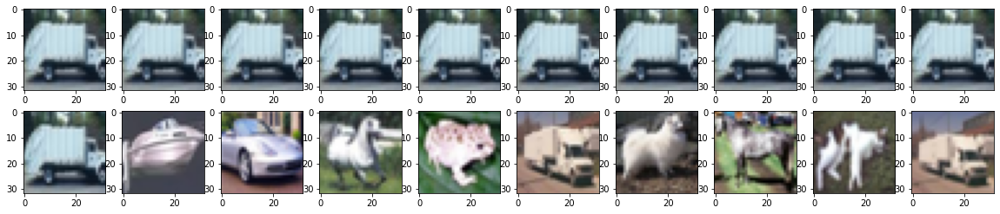

########################################## cosine ################################
(1, 60000)


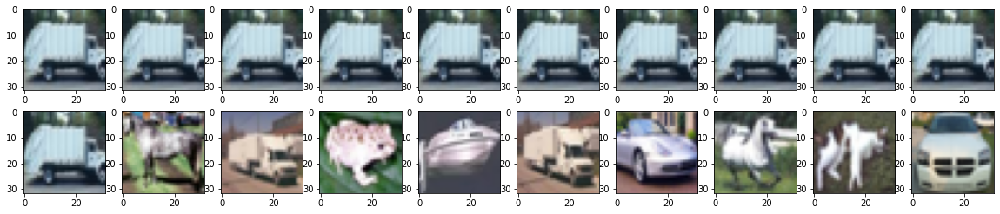

############################################ cat ################################
########################################## manhattan ################################
(1, 60000)


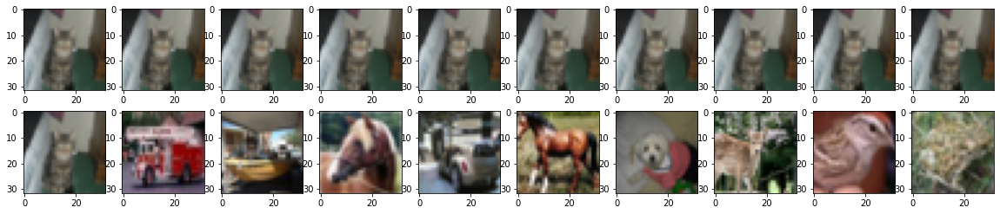

########################################## euclidean ################################
(1, 60000)


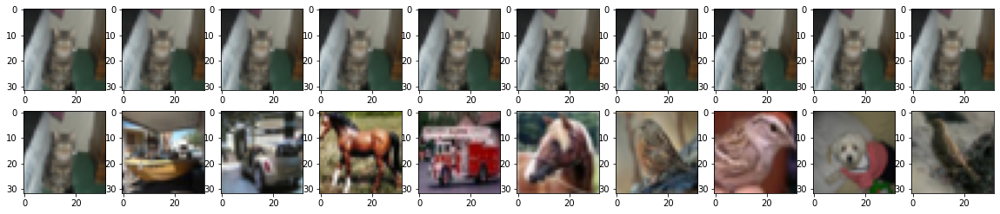

########################################## cosine ################################
(1, 60000)


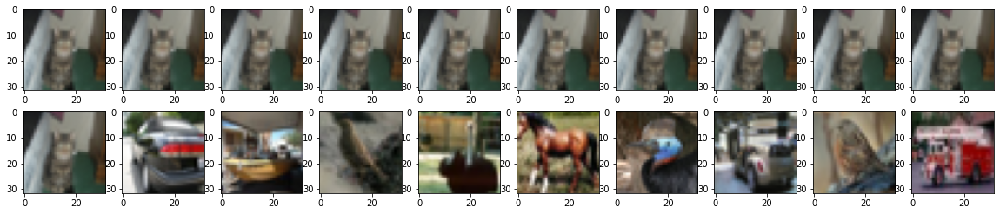

############################################ dog ################################
########################################## manhattan ################################
(1, 60000)


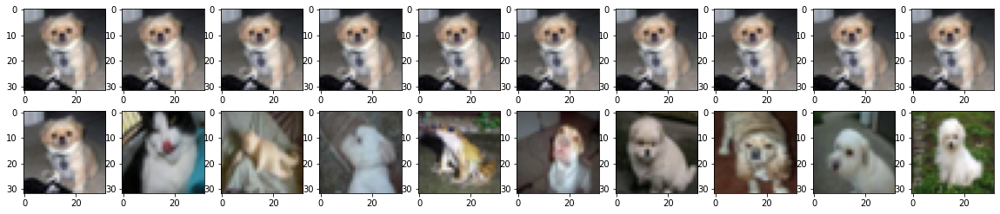

########################################## euclidean ################################
(1, 60000)


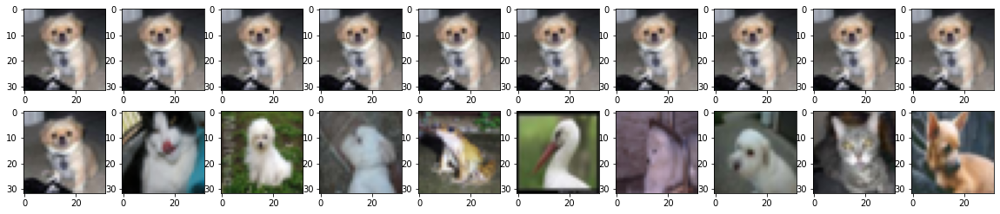

########################################## cosine ################################
(1, 60000)


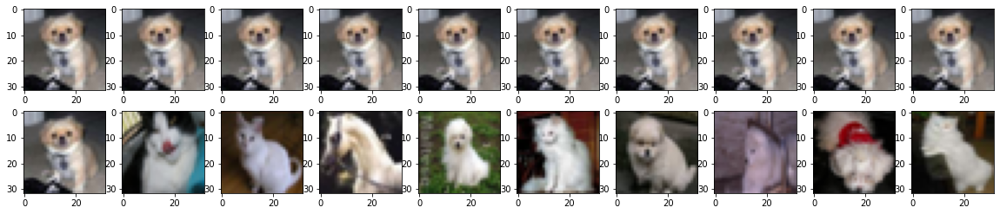

############################################ horse ################################
########################################## manhattan ################################
(1, 60000)


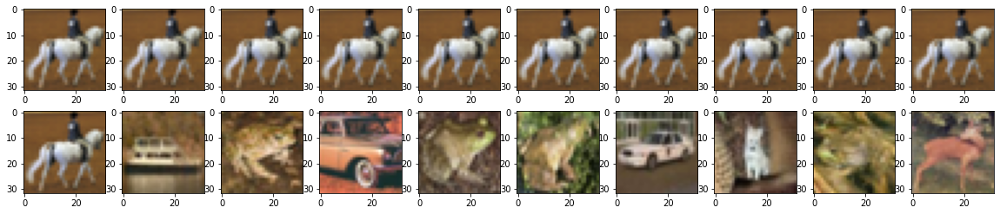

########################################## euclidean ################################
(1, 60000)


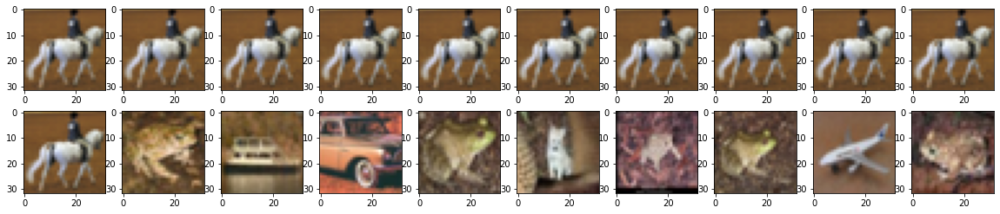

########################################## cosine ################################
(1, 60000)


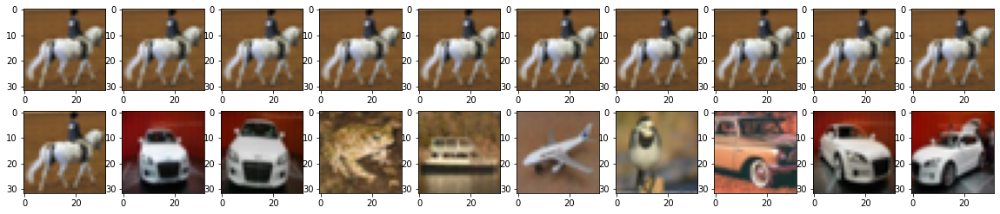

############################################ truck ################################
########################################## manhattan ################################
(1, 60000)


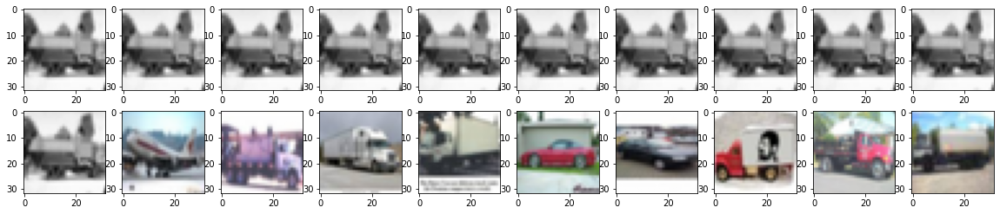

########################################## euclidean ################################
(1, 60000)


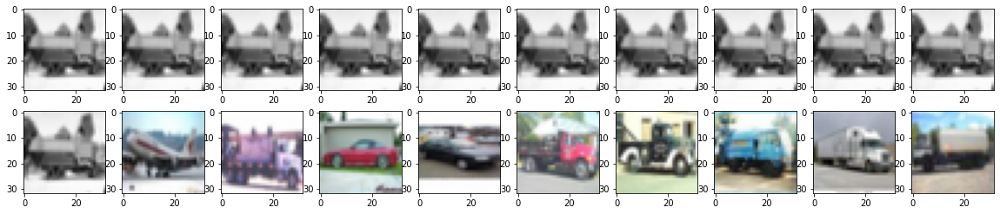

########################################## cosine ################################
(1, 60000)


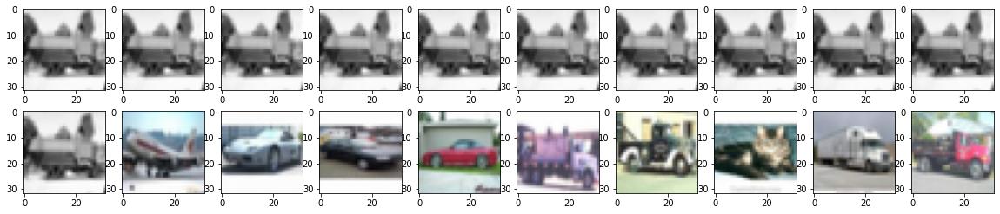

############################################ cat ################################
########################################## manhattan ################################
(1, 60000)


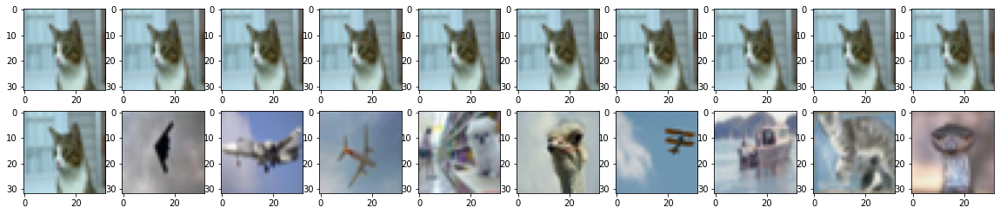

########################################## euclidean ################################
(1, 60000)


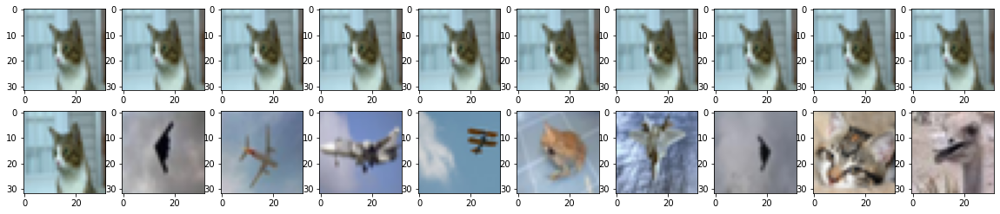

########################################## cosine ################################
(1, 60000)


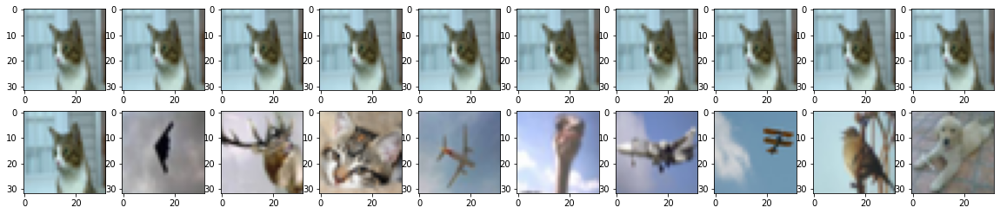

############################################ truck ################################
########################################## manhattan ################################
(1, 60000)


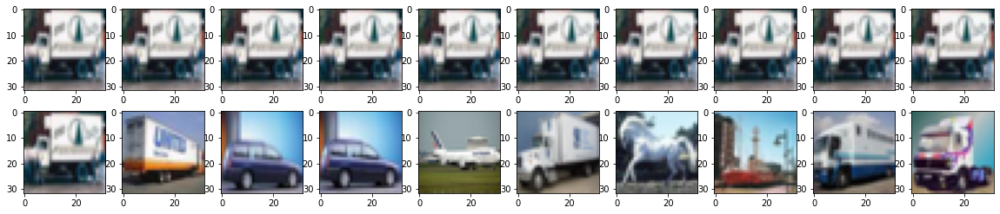

########################################## euclidean ################################
(1, 60000)


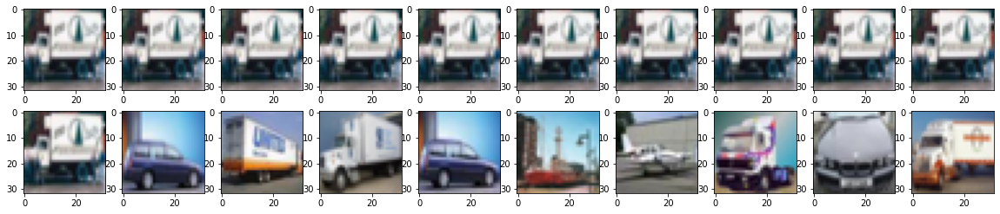

########################################## cosine ################################
(1, 60000)


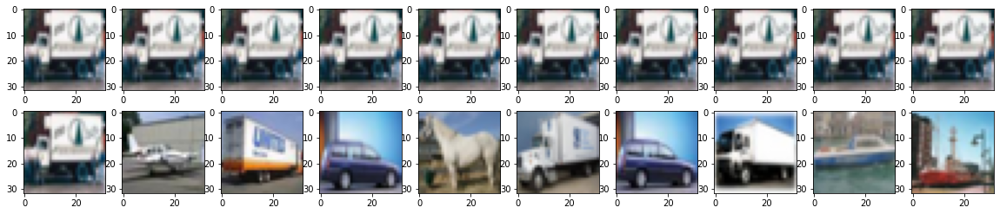

############################################ dog ################################
########################################## manhattan ################################
(1, 60000)


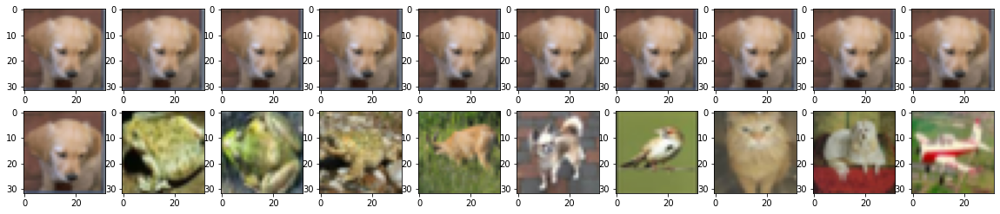

########################################## euclidean ################################
(1, 60000)


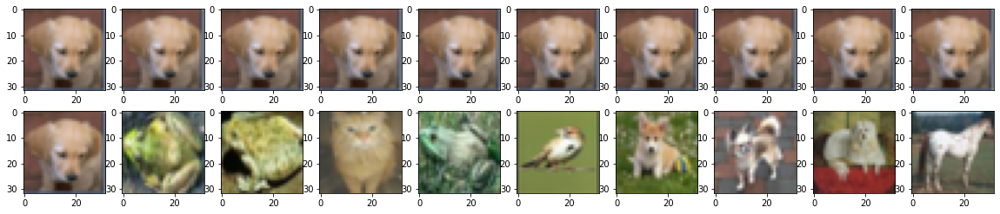

########################################## cosine ################################
(1, 60000)


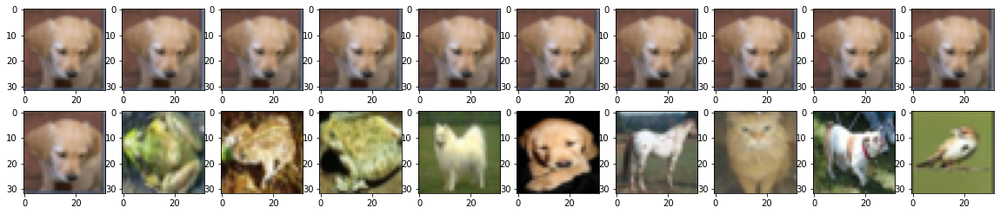

############################################ truck ################################
########################################## manhattan ################################
(1, 60000)


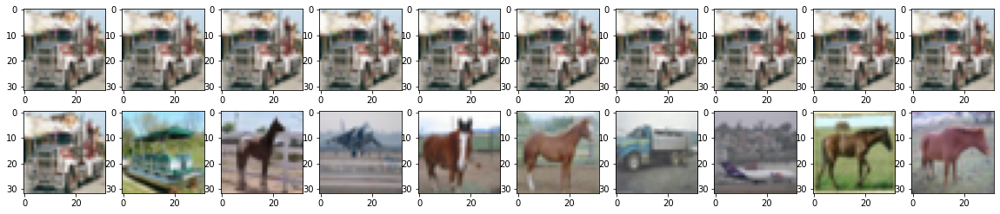

########################################## euclidean ################################
(1, 60000)


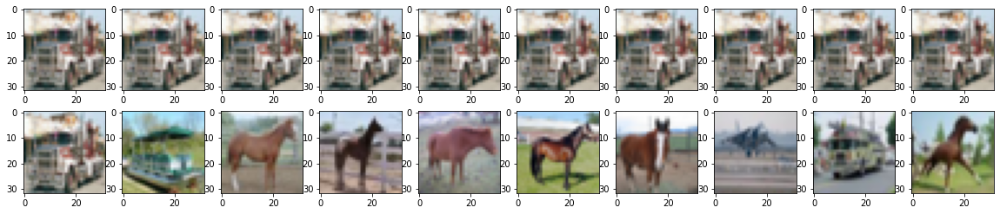

########################################## cosine ################################
(1, 60000)


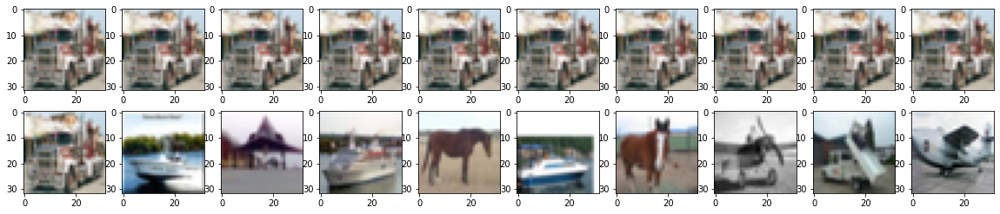

############################################ deer ################################
########################################## manhattan ################################
(1, 60000)


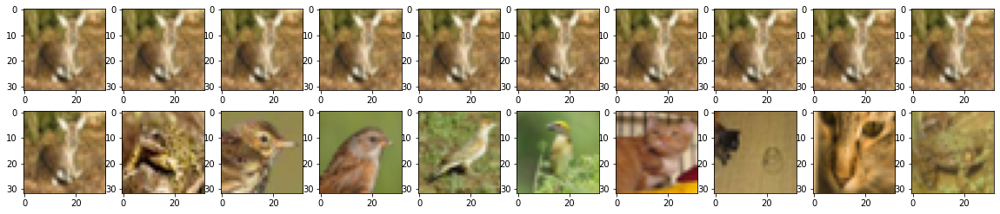

########################################## euclidean ################################
(1, 60000)


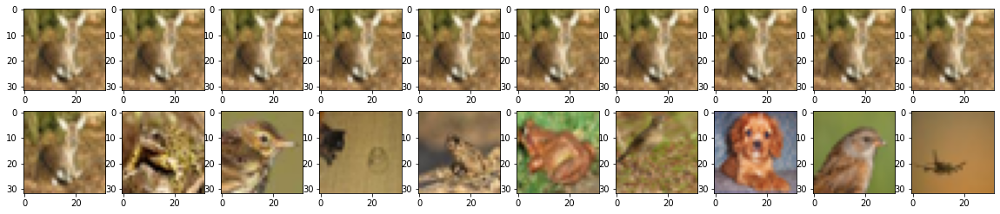

########################################## cosine ################################
(1, 60000)


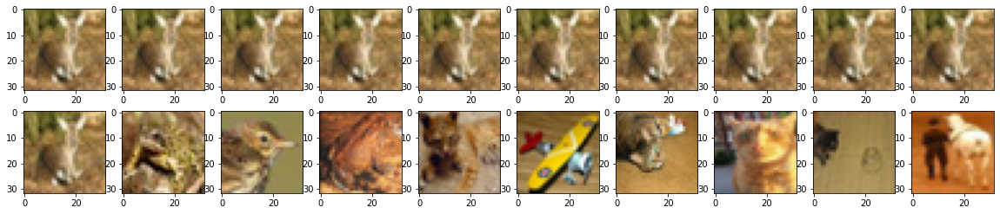

############################################ dog ################################
########################################## manhattan ################################
(1, 60000)


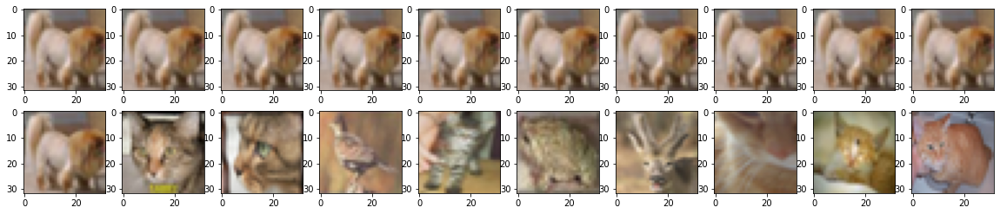

########################################## euclidean ################################
(1, 60000)


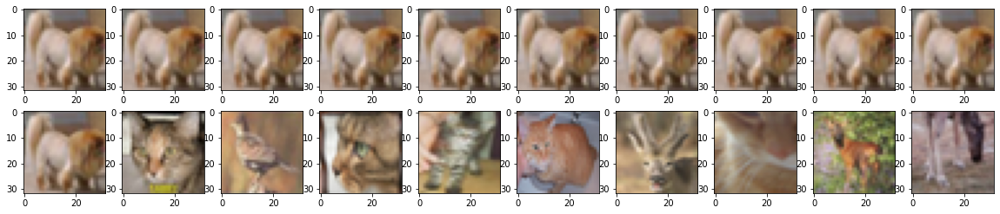

########################################## cosine ################################
(1, 60000)


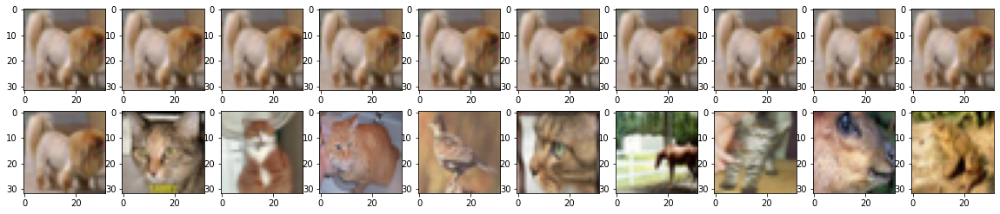

############################################ bird ################################
########################################## manhattan ################################
(1, 60000)


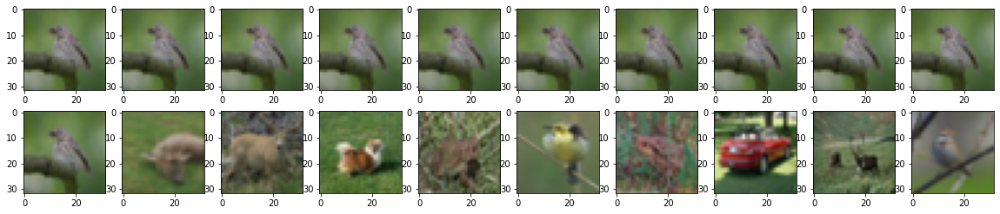

########################################## euclidean ################################
(1, 60000)


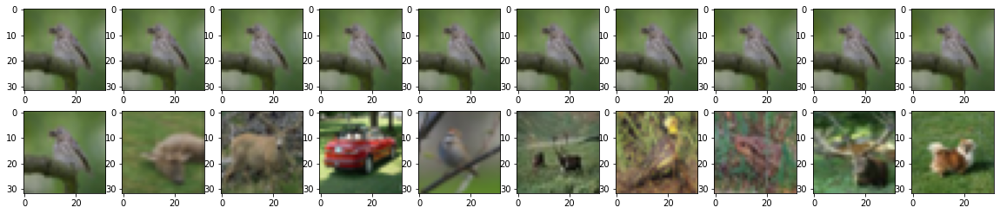

########################################## cosine ################################
(1, 60000)


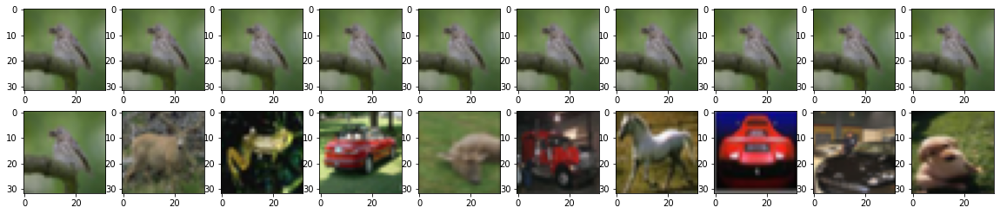

In [81]:
pair_distances(20)